In [1]:
TRAIN = '/kaggle/input/drone-detection-dataset/BirdVsDroneVsAirplane'

We want to use image embeddings for both EDA and classification, so let's introduce some code to get them for us using ResNeXt without fine-tuning.

In [2]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth


100%|██████████| 95.8M/95.8M [00:00<00:00, 189MB/s]


Let's load up all of our data. We have a bunch of broken images, so we need to avoid trying to load them. 

In [3]:
IGNORE = {'137.JPEG', '161.JPEG', '185.JPEG', '186.JPEG', '233.JPEG', '287.JPEG', '320.JPEG', '357.JPEG', '400.JPEG', '419.JPEG', '420.JPEG', '457.JPEG', '508.JPEG', '546.jpeg', '547.jpeg', '550.jpeg',
          '551.jpeg', '552.jpeg', '553.jpeg', '591.jpeg', '62.JPEG', '642.JPEG', '653.JPEG', '66.JPEG', '92.JPEG', 'singleDronesinsky174.jpeg', 'singleDronesinsky50.jpeg', 'singleDronesinsky53.jpeg',
          'singleDronesinsky58.jpeg', 'singleDronesinsky60.jpeg', 'singleDronesinsky62.jpeg', 'singleDronesinsky66.jpeg', 'video14_185.JPEG', 'video14_40.JPEG', }
print(sorted(list(IGNORE)))

['137.JPEG', '161.JPEG', '185.JPEG', '186.JPEG', '233.JPEG', '287.JPEG', '320.JPEG', '357.JPEG', '400.JPEG', '419.JPEG', '420.JPEG', '457.JPEG', '508.JPEG', '546.jpeg', '547.jpeg', '550.jpeg', '551.jpeg', '552.jpeg', '553.jpeg', '591.jpeg', '62.JPEG', '642.JPEG', '653.JPEG', '66.JPEG', '92.JPEG', 'singleDronesinsky174.jpeg', 'singleDronesinsky50.jpeg', 'singleDronesinsky53.jpeg', 'singleDronesinsky58.jpeg', 'singleDronesinsky60.jpeg', 'singleDronesinsky62.jpeg', 'singleDronesinsky66.jpeg', 'video14_185.JPEG', 'video14_40.JPEG']


In [4]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from os.path import isdir
from PIL import Image


THUMBNAIL_SIZE = (64, 64)

def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGBA').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def get_picture_from_glob(arg: str, tag: str,) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[tag, basename(input_file), embed(model=model, filename=input_file), png(filename=input_file)],
                        index=['tag', 'name', 'value', 'png'] )
        for index, input_file in enumerate(list(iglob(pathname=arg))) if (input_file.endswith('.jpg') or input_file.endswith('.jpeg') or input_file.endswith('.JPEG')) and 
             basename(input_file) not in IGNORE]
    print('encoded {} rows of {}  in {}'.format(len(result), tag, arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*') if isdir(folder) }
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in train_dict.items()]))
print('done in {}'.format(arrow.now() - time_start))

encoded 576 rows of Birds  in 0:01:15.904653
encoded 1009 rows of Aeroplanes  in 0:02:17.453650
encoded 674 rows of Drones  in 0:01:54.657476
done in 0:05:28.160580


Our classes are imbalanced; how badly imbalanced are they?

In [5]:
train_df['tag'].value_counts(normalize=True).to_frame().T

tag,Aeroplanes,Drones,Birds
proportion,0.446658,0.298362,0.25498


Let's use TSNE to add x/y coordinates based on our image embeddings. We're going to use them to build an interactive scatter plot.

In [6]:
from sklearn.manifold import TSNE

train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 2259 samples in 0.015s...
[t-SNE] Computed neighbors for 2259 samples in 0.481s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2259
[t-SNE] Computed conditional probabilities for sample 2000 / 2259
[t-SNE] Computed conditional probabilities for sample 2259 / 2259
[t-SNE] Mean sigma: 2.093773
[t-SNE] KL divergence after 250 iterations with early exaggeration: 76.166931
[t-SNE] KL divergence after 1000 iterations: 1.009064


Let's plot.

In [7]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'tag', 'x', 'y']].sample(n=min(len(train_df) - 1, 10000)))
factor_count = max(train_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=train_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: birds/planes/drones', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=6, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? For the most part, our three classes are clustered internally, even though they overlap a little. Let's build a model and see what we get.

In [8]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(train_df['value'].apply(pd.Series), train_df['tag'], test_size=0.25, random_state=2026, stratify=train_df['tag'])
logreg = LogisticRegression(max_iter=2000, tol=1e-12).fit(X_train, y_train)
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=y_test, y_pred=logreg.predict(X=X_test))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=y_test, y_pred=logreg.predict(X=X_test))))
print(classification_report(y_true=y_test, y_pred=logreg.predict(X=X_test), zero_division=0.0))

model fit in 283 iterations
accuracy: 0.9699
f1: 0.9699
              precision    recall  f1-score   support

  Aeroplanes       0.96      0.98      0.97       252
       Birds       0.97      0.98      0.97       144
      Drones       0.98      0.95      0.97       169

    accuracy                           0.97       565
   macro avg       0.97      0.97      0.97       565
weighted avg       0.97      0.97      0.97       565



We have a handful of misclassifications in each class. Not bad. Let's have a look at our model probabilities.

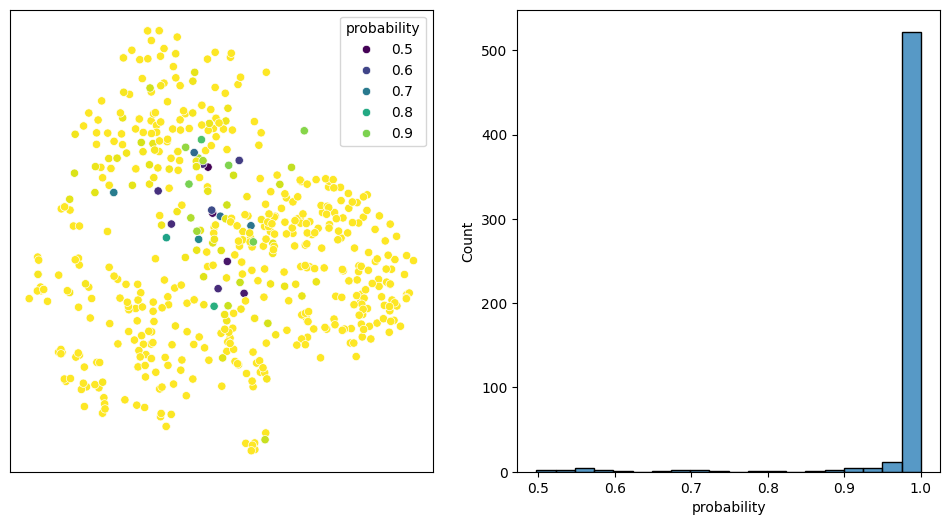

In [9]:
import matplotlib.pyplot as plt
import warnings
from seaborn import histplot
from seaborn import scatterplot

warnings.filterwarnings('ignore', category=FutureWarning, module='seaborn')

plot_df = train_df.iloc[X_test.index][['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=X_test), axis=1)

fig, ax = plt.subplots(ncols=2, figsize=(12, 6))
scatterplot(ax=ax[0], data=plot_df, x='x', y='y', hue='probability', palette='viridis', )
ax[0].set(xlabel=None) 
ax[0].set(ylabel=None)
ax[0].set(xticklabels=[])
ax[0].set(yticklabels=[])
ax[0].tick_params(axis='both', which='both', length=0)
histplot(ax=ax[1], data=plot_df, x='probability', bins=20)
fig.show()

Not surprisingly, our hard cases are on or near the cluster boundaries.